# Path-planning for a formula student racing car

In [197]:
# Necessary imports
import path_planning as pp
import matplotlib.pyplot as plt
import pickle
import numpy as np
import pandas as pd
import os
from scipy.spatial import ConvexHull, Delaunay
from scipy.interpolate import splprep, splev
from IPython.display import HTML
import matplotlib.animation
from concave_hull import concave_hull

# Plotting style
plt.style.use('seaborn-whitegrid')
plt.rcParams['figure.figsize'] = (10, 10)

## Loading the tracks

In [199]:
path_tracks_inventory = '../FSD_tracks_inventory/'

# SLAM global map (oval track, simulated in Gazebo)
with open(path_tracks_inventory + 'pickle/SLAM_map_oval_track.pickle', 'rb') as f:
    SLAM_map_dict = pickle.load(f)

# getting the paths of the csv files for the track drive, skidpad and acceleration 
paths_trackdrive, paths_skidpad, paths_acceleration = [], [], []

for root, dirs, files in os.walk(path_tracks_inventory + 'csv/'):
    for name in files:
        if not name.endswith('.csv'):
            continue
        elif name.startswith('fsds') and not name.endswith('center_line.csv'):  # getting all the track drive csv files
            paths_trackdrive.append(os.path.join(root, name))
        elif name.endswith('skidpad_cones.csv'):                                # getting all the skidpad csv files
            paths_skidpad.append(os.path.join(root, name))
        elif name.endswith('acceleration_cones.csv'):                           # getting all the acceleration csv files
            paths_acceleration.append(os.path.join(root, name))

trackdrive_tracks = [pd.read_csv(path) for path in paths_trackdrive]
skidpad_tracks = [pd.read_csv(path) for path in paths_skidpad]
acceleration_tracks = [pd.read_csv(path) for path in paths_acceleration]

## Path-planning on track drive tracks

### Track drive #0

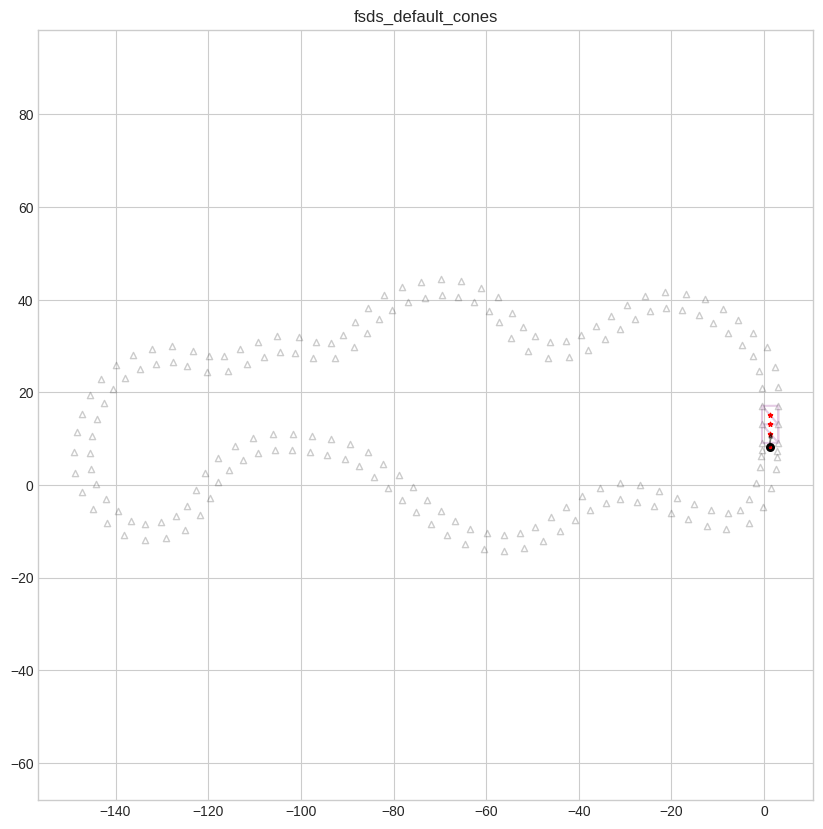

In [256]:
title = paths_trackdrive[2].split('/')[-1].split('.')[0]
cone_positions = trackdrive_tracks[2][['X', 'Y']].values
car_pos , car_yaw = np.array([0.0, 9.0], dtype='float64'), np.deg2rad(90)

fig, ax = plt.subplots()

def track_test(i):
    global car_pos, car_yaw, path

    if i == 0: # skip the first frame
        return
    
    ax.clear()

    front_cones = pp.get_nearest_front_cones(car_pos, car_yaw, cone_positions, 6, max_distance=30)
    tri = Delaunay(front_cones)
    waypoints = pp.extract_waypoints(front_cones, car_pos)

    # x, y = np.append([car_pos], waypoints, axis=0).T
    # tck_, u_ = splprep([x,y], s=2)
    # u_new_ = np.linspace(u_.min(), u_.max()*1.1, 10)
    # x_new_, y_new_ = splev(u_new_, tck_, der=0)

    # plot the delaunay triangulation
    ax.triplot(front_cones[:, 0], front_cones[:, 1], tri.simplices.copy(), alpha=0.2, color='purple')
    # plot the waypoints
    ax.scatter(waypoints[:, 0], waypoints[:, 1], c='r', s=10, marker='*')
    # plot the path interpolation
    # ax.plot(x_new_, y_new_, 'r-', alpha=0.5)

    # plot the car
    ax.scatter(car_pos[0], car_pos[1], c='r', s=20, marker='o', edgecolors='k', linewidths=2)
    ax.arrow(car_pos[0], car_pos[1], 2*np.cos(car_yaw), 2*np.sin(car_yaw), head_width=0.7, head_length=1, fc='k', ec='k', alpha=0.5)
    # plot the track
    ax.scatter(cone_positions[:, 0], cone_positions[:, 1], c='w', s=20, marker='^', edgecolors='k', alpha=0.2)
    # general styling
    ax.set_title(title)
    plt.axis('equal')

    
    car_yaw = np.arctan2(waypoints[0][1] - car_pos[1], waypoints[0][0] - car_pos[0])
    # car_pos = [x_new_[1], y_new_[1]]
    car_pos = waypoints[0]

ani0 = matplotlib.animation.FuncAnimation(fig, track_test, frames=100, interval=200)

HTML(ani0.to_jshtml())

### Track drive #1

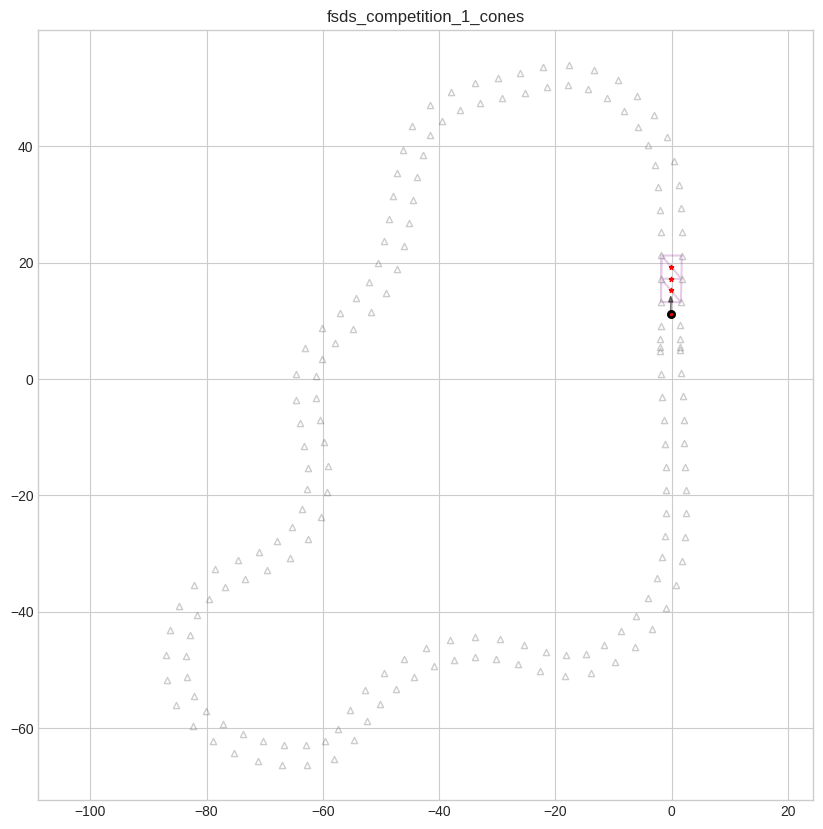

In [258]:
title = paths_trackdrive[3].split('/')[-1].split('.')[0]
car_pos , car_yaw = car = np.array([0.0, 9.0], dtype='float64'), np.deg2rad(90)
cone_positions = trackdrive_tracks[3][['X', 'Y']].values

fig, ax = plt.subplots()
ani1 = matplotlib.animation.FuncAnimation(fig, track_test, frames=90, interval=200)
HTML(ani1.to_jshtml())

### Track drive #2

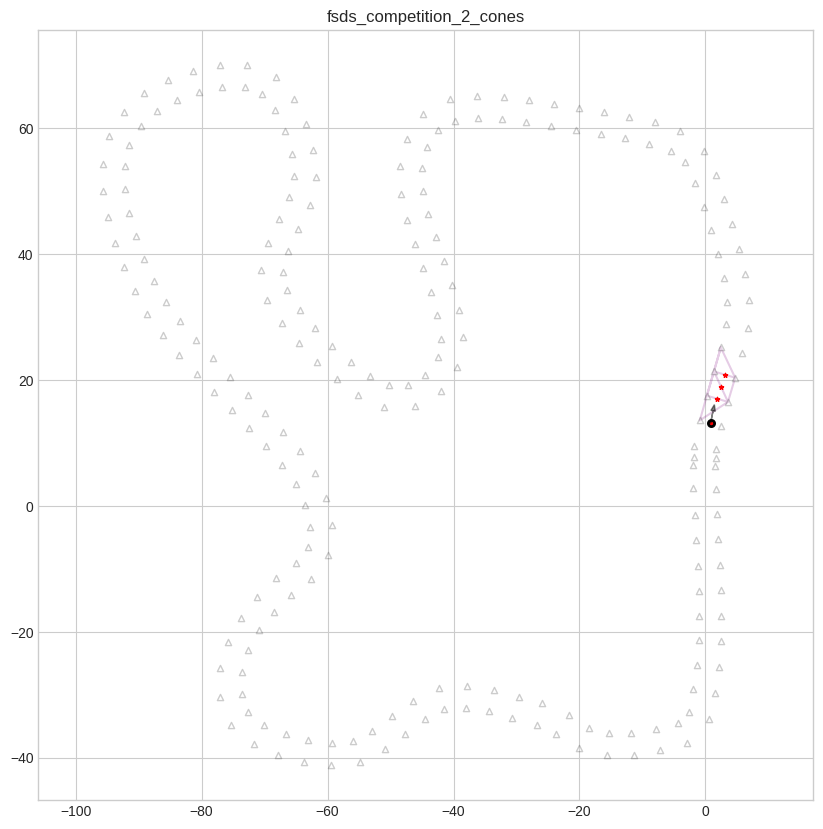

In [254]:
title = paths_trackdrive[1].split('/')[-1].split('.')[0]
car_pos , car_yaw = car = np.array([0.0, 9.0], dtype='float64'), np.deg2rad(90)
cone_positions = trackdrive_tracks[1][['X', 'Y']].values

fig, ax = plt.subplots()
ani2 = matplotlib.animation.FuncAnimation(fig, track_test, frames=120, interval=200)
HTML(ani2.to_jshtml())

### Track drive #3

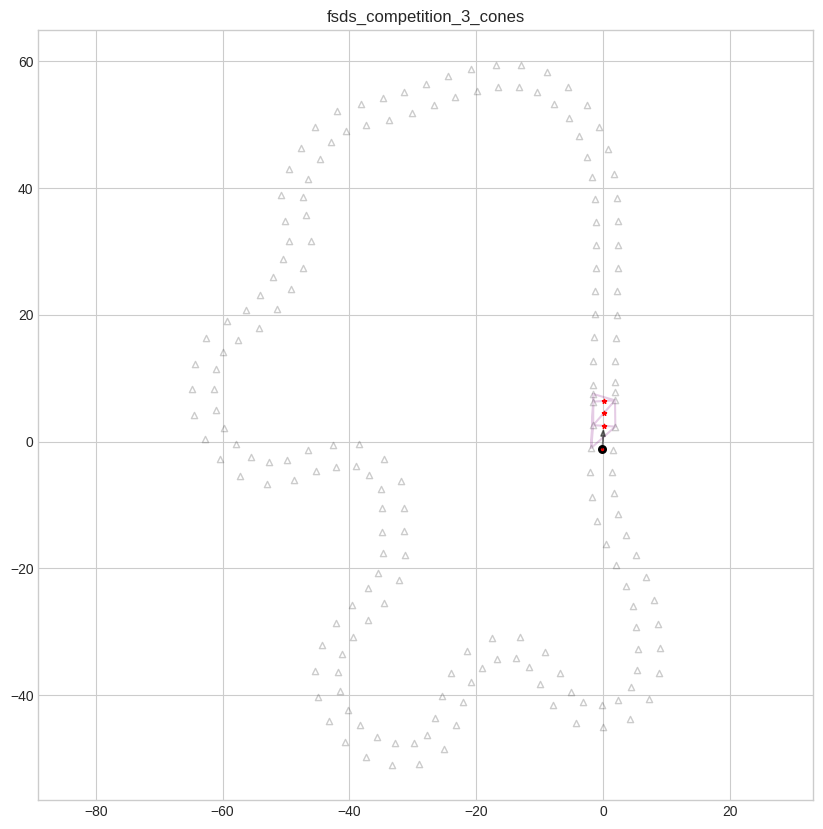

In [248]:
title = paths_trackdrive[0].split('/')[-1].split('.')[0]
car_pos , car_yaw = car = np.array([0.0, 9.0], dtype='float64'), np.deg2rad(90)
cone_positions = trackdrive_tracks[0][['X', 'Y']].values

fig, ax = plt.subplots()
ani3 = matplotlib.animation.FuncAnimation(fig, track_test, frames=90, interval=200)
HTML(ani3.to_jshtml())

In [ ]:
from IPython.display import HTML
import matplotlib.animation
from concave_hull import concave_hull

car_pos , car_yaw = car['pos'], car['yaw']
step = -1
path = np.array([], dtype=np.float64).reshape(0, 2)
path = np.append(path, [car_pos], axis=0)
cone_positions = trackdrive_tracks[0][['X', 'Y']].values

fig, ax = plt.subplots()

def animate(i):
    global car_pos, car_yaw, path, step

    if i == 0:
        return

    step += 1
    car_pos = path[-1]
    car_yaw = np.arctan2(path[-1][1] - path[-2][1], path[-1][0] - path[-2][0]) if len(path) > 1 else np.deg2rad(90)
    
    nearest_front_cones = tr.get_nearest_front_cones(car_pos, car_yaw, cone_positions, 6)
    
    tri = Delaunay(nearest_front_cones)
    midpoints = []
    for i in range(len(tri.simplices)):
        midpoints.append((nearest_front_cones[tri.simplices[i][0]] + nearest_front_cones[tri.simplices[i][1]]) / 2)
        midpoints.append((nearest_front_cones[tri.simplices[i][0]] + nearest_front_cones[tri.simplices[i][2]]) / 2)
        midpoints.append((nearest_front_cones[tri.simplices[i][1]] + nearest_front_cones[tri.simplices[i][2]]) / 2)
    midpoints = np.array(midpoints)

    # remove duplicates
    midpoints = np.unique(midpoints, axis=0)

    # boundary points
    boundary_points = concave_hull(nearest_front_cones, 0.5)

    # calculate center of mass of the boundary points
    center_of_mass = np.mean(boundary_points, axis=0)

    # find the midpoints that are inside the boundary
    midpoints_inside = []
    for i in range(len(midpoints)):
        if tr.point_is_inside_polygon(midpoints[i], boundary_points):
            midpoints_inside.append(midpoints[i])

    midpoints_inside = np.array(midpoints_inside)
    midpoints_inside = tr.nnb_sorting(midpoints_inside, car_pos)

    # ---- path ----

    path = np.append(path, midpoints_inside[:], axis=0)
    length_epath = min(12, min(8, max(4, path.shape[0])))
    x, y = path[-length_epath:,0], path[-length_epath:,1]
    tck_, u_ = splprep([x,y], s=2)
    u_new_ = np.linspace(u_.min(), u_.max(), 50)
    x_new_, y_new_ = splev(u_new_, tck_, der=0)


    # extrapolated 
    w = np.ones_like(x)
    w[-(length_epath//2):] *= 1.5
    tck, u = splprep([x,y], s=2, w = w)
    u_new = np.linspace(u.min(), u.max(), 50)
    x_new, y_new = splev(u_new*1.5, tck, der=0)

    # ---- plotting ---

    ax.clear()
    ax.cla()
    # cones
    ax.scatter(cone_positions[:, 0], cone_positions[:, 1], c='w', marker='^', s=50, edgecolors='black', alpha=0.2, label='cones')
    # car
    ax.scatter(car_pos[0], car_pos[1], c='r', marker='o', s=75, edgecolors='black', label='car')
    ax.arrow(car_pos[0], car_pos[1], 0.2 * np.cos(car_yaw), 0.2 * np.sin(car_yaw), head_width=0.1, head_length=0.1, fc='r', ec='k')
    # detected front cones
    ax.scatter(nearest_front_cones[:, 0], nearest_front_cones[:, 1], c='w', marker='^', s=50, edgecolors='black')
    # delaunay triangulation
    ax.triplot(nearest_front_cones[:, 0], nearest_front_cones[:, 1], tri.simplices.copy(), alpha=0.2)
    # center of mass
    # ax.scatter(center_of_mass[0], center_of_mass[1], c='b', marker='2', s=25, edgecolors='black', label='center of mass')
    # extrapolated path
    ax.plot(x_new, y_new, 'r-', alpha=0.1, linewidth=4, label='extrapolated path')
    #path
    ax.plot(path[:, 0], path[:, 1], 'r.--', alpha=0.7, label='path')
    ax.set_title('Frame {}'.format(step))
    plt.axis('equal')
    plt.legend(bbox_to_anchor=(.75, 1), loc='upper left', borderaxespad=0., frameon=True)


ani = matplotlib.animation.FuncAnimation(fig, animate, frames=11+1, interval=400)

# ani.save('animation.gif', writer='imagemagick', fps=1)

HTML(ani.to_jshtml())

## Path planning on Skidpad tracks

### Oval track

(-0.6888988096266985,
 3.3811012510210277,
 -1.841666667039196,
 2.558333267395693)

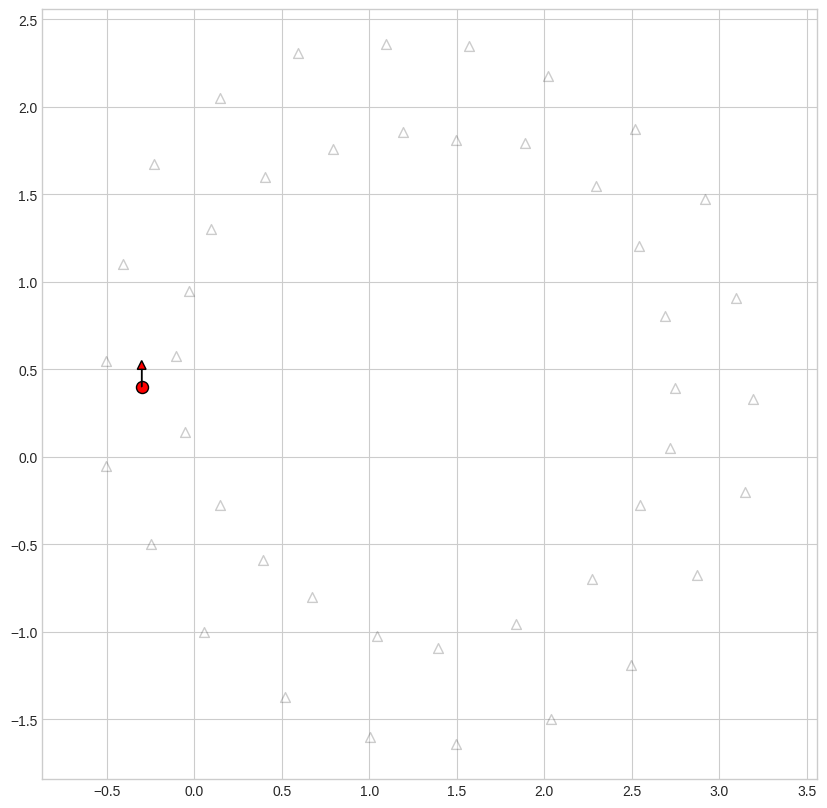

In [194]:
car_pos , car_yaw = SLAM_map_dict['car_pos'], SLAM_map_dict['car_yaw']
cone_positions = SLAM_map_dict['cone_positions'] 

plt.scatter(cone_positions[:, 0], cone_positions[:, 1], c='w', marker='^', s=50, edgecolors='black', alpha=0.2, label='cones')
plt.scatter(car_pos[0], car_pos[1], c='r', marker='o', s=75, edgecolors='black', label='car')
plt.arrow(car_pos[0], car_pos[1], 0.1 * np.cos(car_yaw), 0.1 * np.sin(car_yaw), head_width=0.05, head_length=0.05, fc='r', ec='k')
plt.axis('equal')


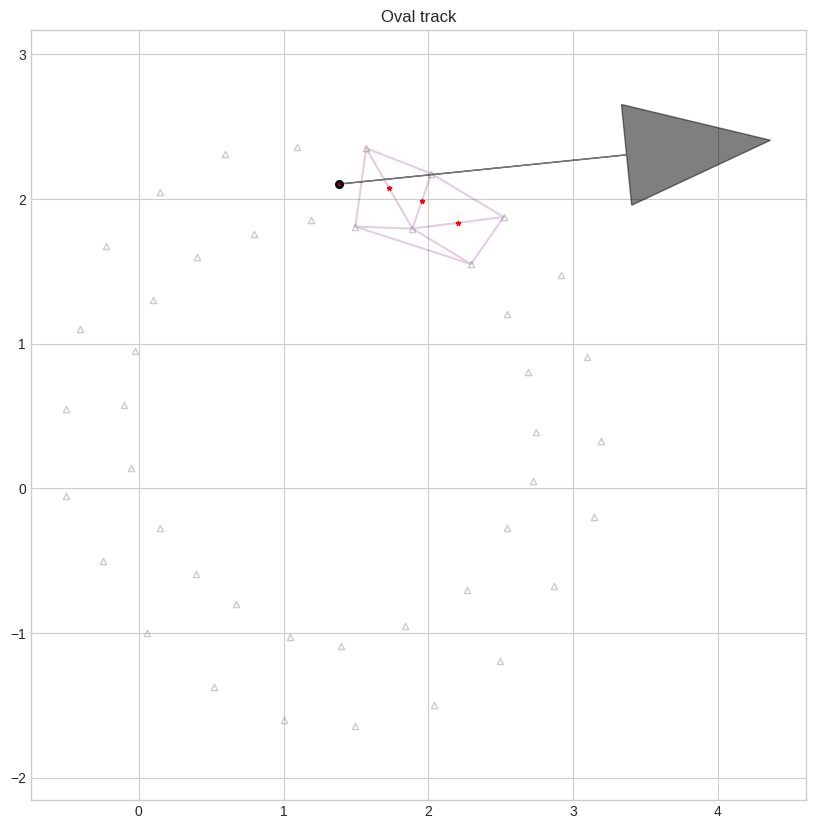

In [261]:
title = 'Oval track'
car_pos , car_yaw = car = SLAM_map_dict['car_pos'], SLAM_map_dict['car_yaw']
cone_positions = SLAM_map_dict['cone_positions']

fig, ax = plt.subplots()
ani4 = matplotlib.animation.FuncAnimation(fig, track_test, frames=30, interval=200)
HTML(ani4.to_jshtml())

### Short skidpad

(-21.725, 21.725, -1.75, 36.75)

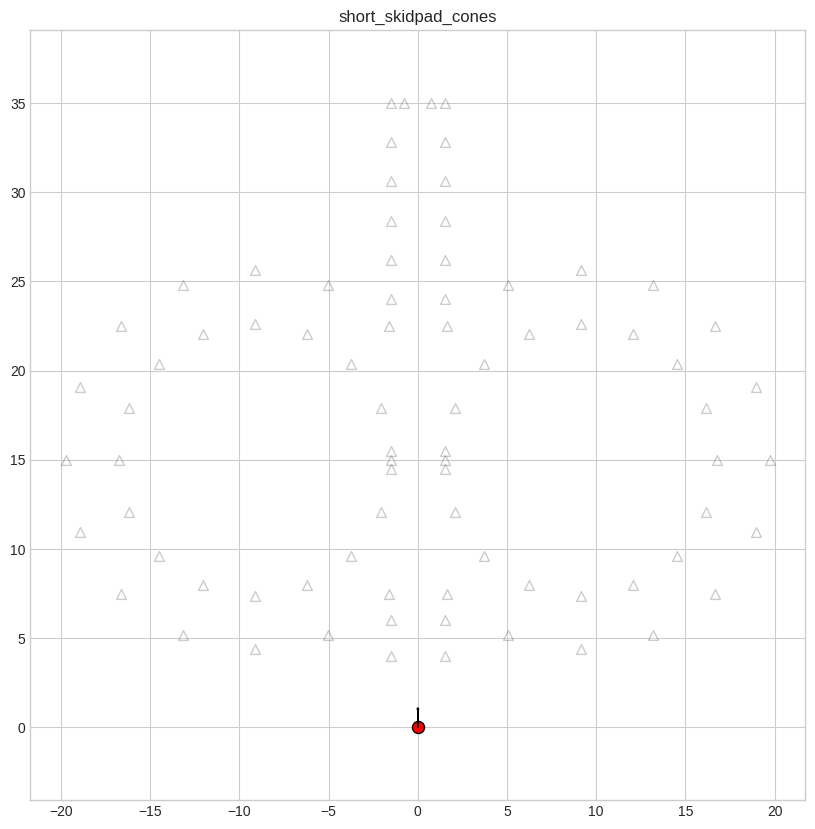

In [196]:
car_pos , car_yaw = car = np.array([0.0, 0.0], dtype='float64'), np.deg2rad(90)
cone_positions = skidpad_tracks[1][['X', 'Y']].values

plt.scatter(cone_positions[:, 0], cone_positions[:, 1], c='w', marker='^', s=50, edgecolors='black', alpha=0.2, label='cones')
plt.scatter(car_pos[0], car_pos[1], c='r', marker='o', s=75, edgecolors='black', label='car')
plt.arrow(car_pos[0], car_pos[1], 1 * np.cos(car_yaw), 1 * np.sin(car_yaw), head_width=0.1, head_length=0.1, fc='r', ec='k')
plt.title(paths_skidpad[0].split('/')[-1].split('.')[0])
plt.axis('equal')

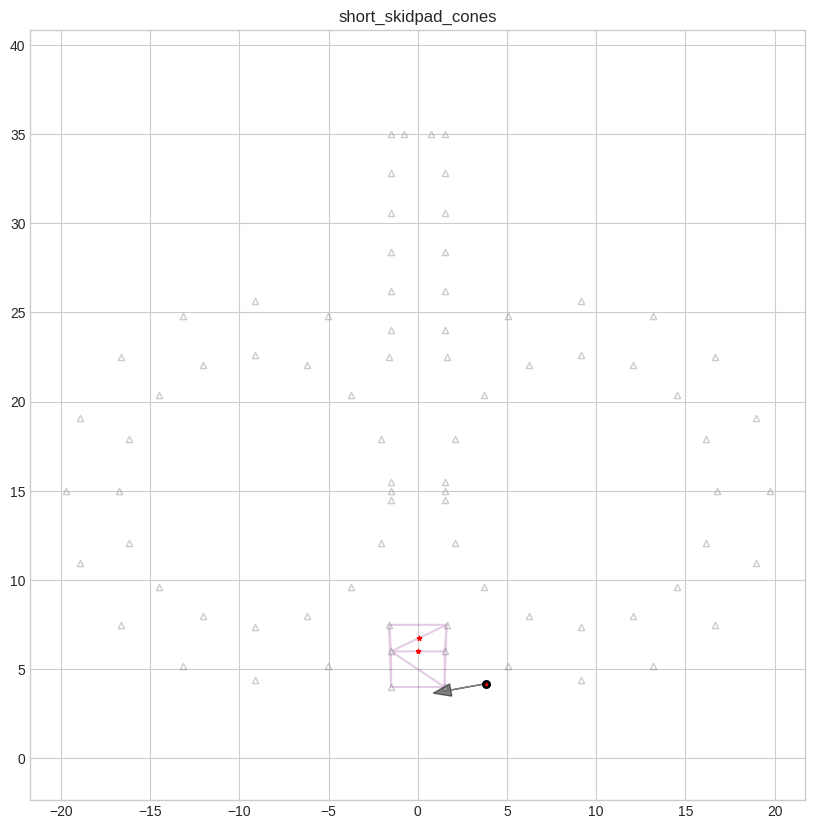

In [265]:
title = paths_skidpad[0].split('/')[-1].split('.')[0]
car_pos , car_yaw = car = np.array([0.0, 2.0], dtype='float64'), np.deg2rad(90)
cone_positions = skidpad_tracks[0][['X', 'Y']].values

fig, ax = plt.subplots()
ani5 = matplotlib.animation.FuncAnimation(fig, track_test, frames=10, interval=200)
HTML(ani5.to_jshtml())